In [1]:
cd ../../utils/hand3d/

/vision2/u/ianhuang/VidObjClassHierarchy/utils/hand3d


In [2]:
from __future__ import print_function, unicode_literals

import tensorflow as tf
import numpy as np
import scipy.misc
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

from nets.ColorHandPose3DNetwork import ColorHandPose3DNetwork
from utils.general import detect_keypoints, trafo_coords, plot_hand, plot_hand_3d



In [3]:
# images to be shown
image_list = list()
image_list.append('./data/img.png')
image_list.append('./data/img2.png')
image_list.append('./data/img3.png')
image_list.append('./data/img4.png')
image_list.append('./data/img5.png')

image_list.append('/vision2/u/ianhuang/VidObjClassHierarchy/viz/viz_data/tmp_dataset/P01/P01_01/0000025921.jpg')

# network input
image_tf = tf.placeholder(tf.float32, shape=(1, 240, 320, 3))
hand_side_tf = tf.constant([[1.0, 0.0]])  # left hand (true for all samples provided)
evaluation = tf.placeholder_with_default(True, shape=())

# build network
net = ColorHandPose3DNetwork()
hand_scoremap_tf, image_crop_tf, scale_tf, center_tf,\
keypoints_scoremap_tf, keypoint_coord3d_tf = net.inference(image_tf, hand_side_tf, evaluation)

# Start TF
gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.8)
sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

# initialize network
net.init(sess)



For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use the `axis` argument instead
Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Loaded 32 variables from ./weights/handsegnet-rhd.pickle
Loaded 102 variables from ./weights/posenet3d-rhd-stb-slr-finetuned.pickle


In [11]:
import os
import random 
all_files = os.listdir('../../viz/viz_data/tmp_dataset/P01/P01_01/')
file_names = [all_files[random.randint(0, len(all_files))] for i in range(100)]
video_sources = [os.path.join('../../viz/viz_data/tmp_dataset/P01/P01_01/', element) for element in file_names]
video_sources

['../../viz/viz_data/tmp_dataset/P01/P01_01/0000024871.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000081241.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000098191.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000061081.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000056641.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000079201.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000057961.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000098461.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000063031.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000014611.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000048421.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000051001.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000032011.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000060961.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000010411.jpg',
 '../../viz/viz_data/tmp_dataset/P01/P01_01/0000018691.jpg',
 '../../viz/viz_data/tmp

/sailhome/ianhuang/anaconda3/envs/.vidobj/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  after removing the cwd from sys.path.
/sailhome/ianhuang/anaconda3/envs/.vidobj/lib/python3.6/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.3.0.
Use Pillow instead: ``numpy.array(Image.fromarray(arr).resize())``.
  """


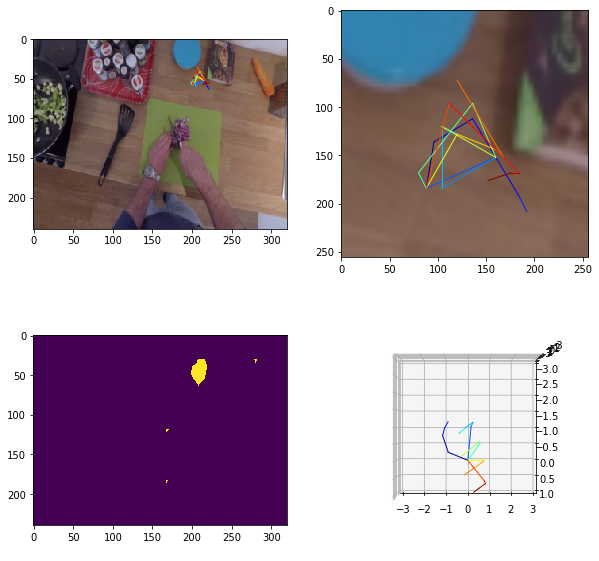

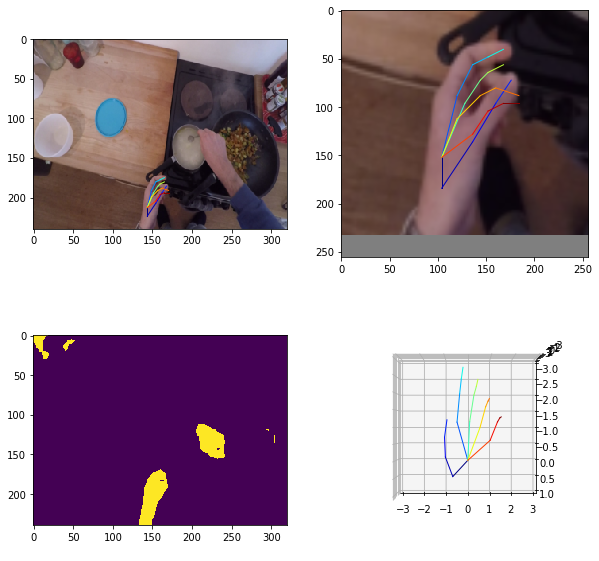

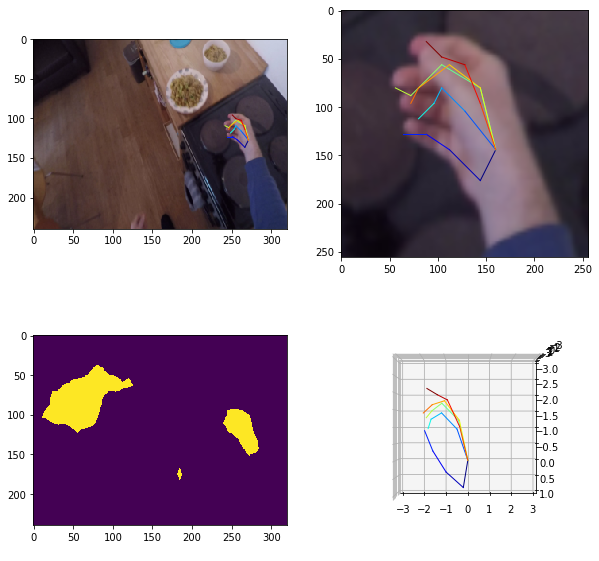

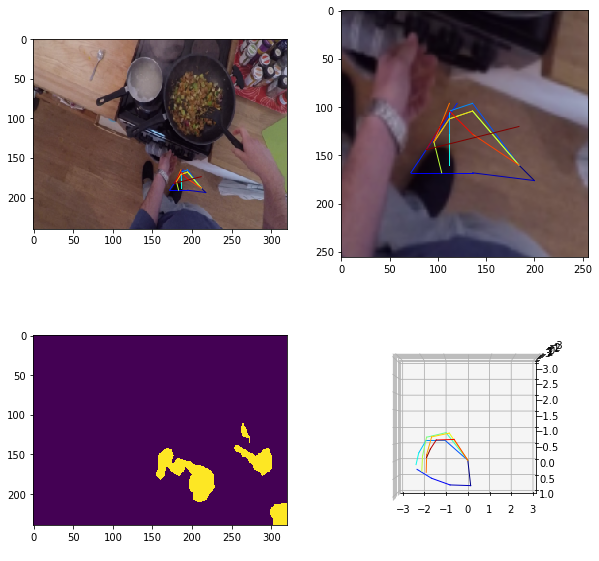

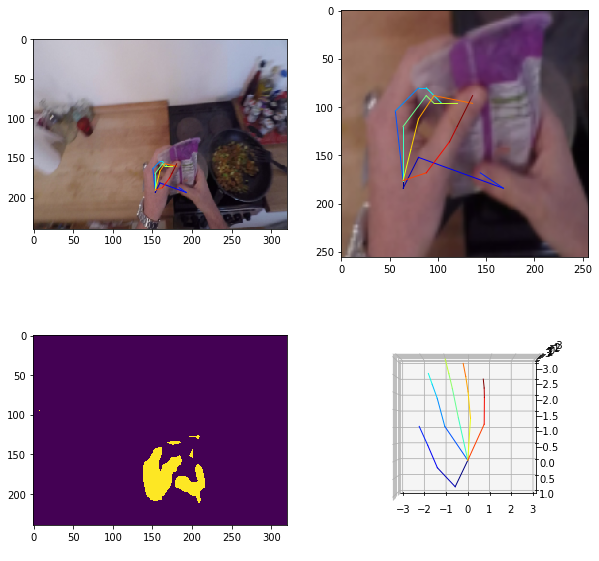

...

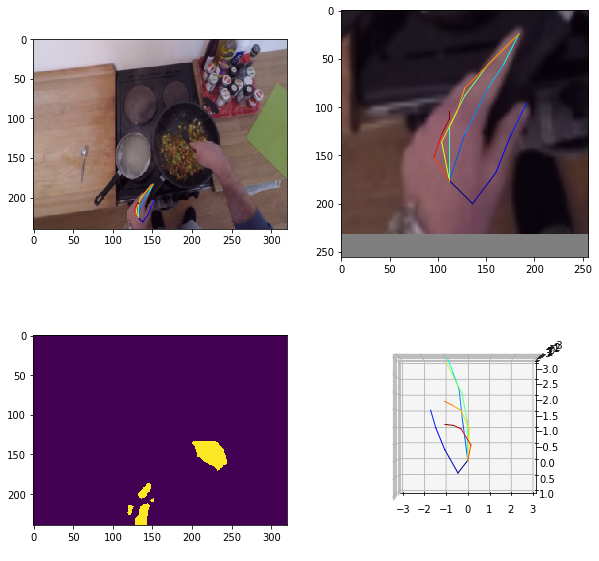

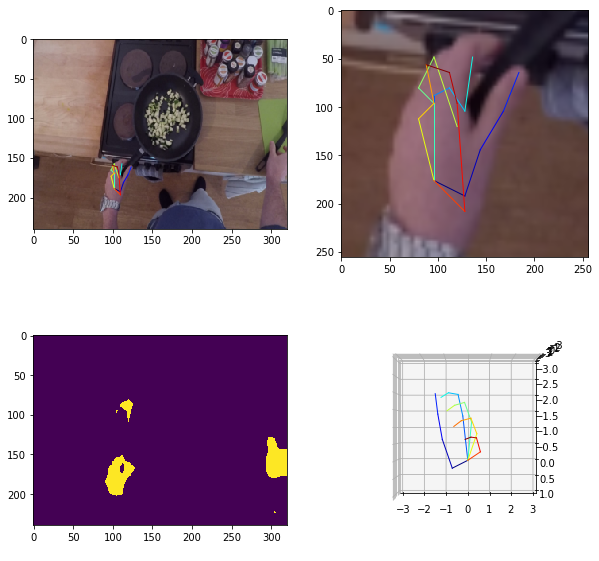

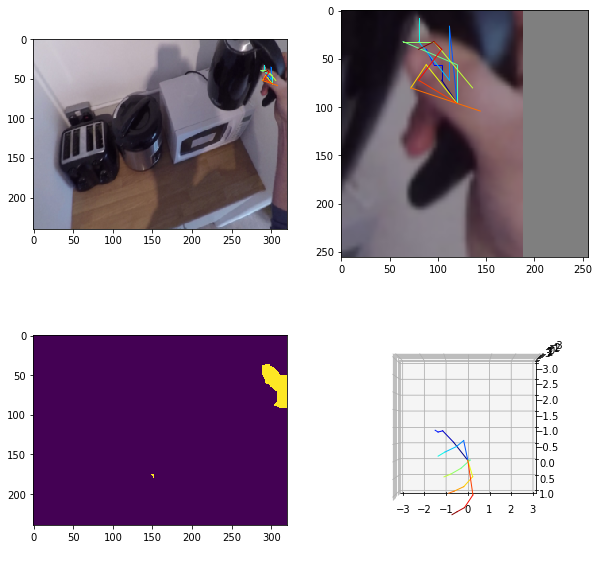

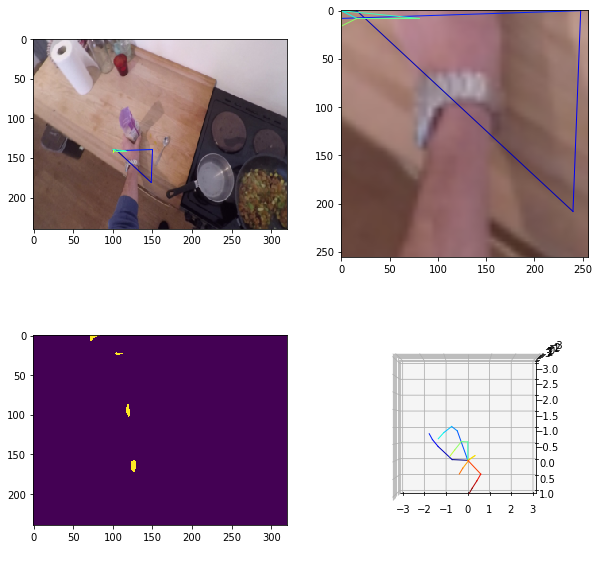

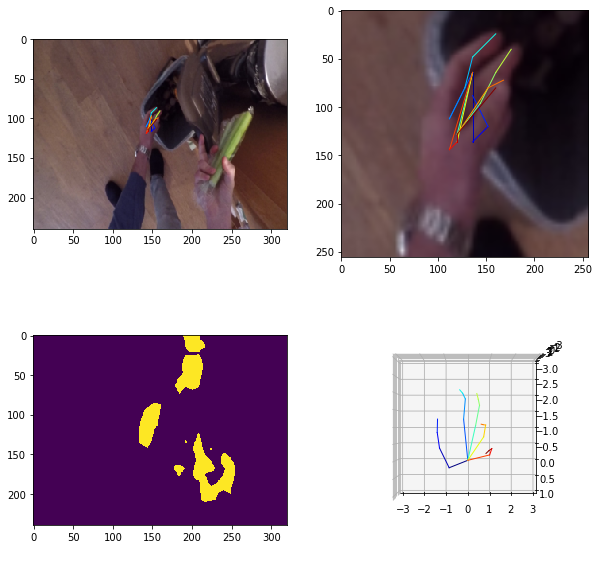

In [12]:

# Feed image list through network
for img_name in video_sources:
    image_raw = scipy.misc.imread(img_name)
    image_raw = scipy.misc.imresize(image_raw, (240, 320))
    image_v = np.expand_dims((image_raw.astype('float') / 255.0) - 0.5, 0)

    hand_scoremap_v, image_crop_v, scale_v, center_v,\
    keypoints_scoremap_v, keypoint_coord3d_v = sess.run([hand_scoremap_tf, image_crop_tf, scale_tf, center_tf,
                                                         keypoints_scoremap_tf, keypoint_coord3d_tf],
                                                        feed_dict={image_tf: image_v})

    hand_scoremap_v = np.squeeze(hand_scoremap_v)
    image_crop_v = np.squeeze(image_crop_v)
    keypoints_scoremap_v = np.squeeze(keypoints_scoremap_v)
    keypoint_coord3d_v = np.squeeze(keypoint_coord3d_v)

    # post processing
    image_crop_v = ((image_crop_v + 0.5) * 255).astype('uint8')
    coord_hw_crop = detect_keypoints(np.squeeze(keypoints_scoremap_v))
    coord_hw = trafo_coords(coord_hw_crop, center_v, scale_v, 256)

    # visualize
    fig = plt.figure(1, figsize=(10,10))
    ax1 = fig.add_subplot(221)
    ax2 = fig.add_subplot(222)
    ax3 = fig.add_subplot(223)
    ax4 = fig.add_subplot(224, projection='3d')
    ax1.imshow(image_raw)
    plot_hand(coord_hw, ax1)
    ax2.imshow(image_crop_v)
    plot_hand(coord_hw_crop, ax2)
    ax3.imshow(np.argmax(hand_scoremap_v, 2))
    plot_hand_3d(keypoint_coord3d_v, ax4)
    ax4.view_init(azim=-90.0, elev=-90.0)  # aligns the 3d coord with the camera view
    ax4.set_xlim([-3, 3])
    ax4.set_ylim([-3, 1])
    ax4.set_zlim([-3, 3])
    plt.show()